<a href="https://colab.research.google.com/github/anshupandey/Working_with_Large_Language_models/blob/main/WWL_C17_VertexAI_Imagen2_image_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Generation with Imagen on Vertex AI


## Overview

[Imagen on Vertex AI](https://cloud.google.com/vertex-ai/docs/generative-ai/image/overview) brings Google's state of the art generative AI capabilities to application developers. With Imagen on Vertex AI, application developers can build next-generation AI products that transform their user's imagination into high quality visual assets, in seconds.

With Imagen, you can do the following:
- Generate novel images using only a text prompt (text-to-image generation).
- Edit an entire uploaded or generated image with a text prompt.
- Edit only parts of an uploaded or generated image using a mask area you define.
- Upscale existing, generated, or edited images.
- Fine-tune a model with a specific subject (for example, a specific handbag or shoe) for image generation.
- Get text descriptions of images with visual captioning.
- Get answers to a question about an image with Visual Question Answering (VQA).

This notebook focuses on **image generation** only. You can read more about image generation feature from Imagen [here](https://cloud.google.com/vertex-ai/docs/generative-ai/image/generate-images).


### Objectives

In this notebook, you will be exploring the image generation features of Imagen using the Vertex AI Python SDK. You will:

- generate images using text prompts
- experiment with different parameters, such as:
    - increasing the number of images to be generated
    - fixing a seed number for reproducibility
    - influencing the output images using negative prompts

### Costs

- This notebook uses billable components of Google Cloud:
  - Vertex AI (Imagen)

- Learn about [Vertex AI pricing](https://cloud.google.com/vertex-ai/pricing) and use the [Pricing Calculator](https://cloud.google.com/products/calculator/) to generate a cost estimate based on your projected usage.

## Getting Started

### Install Vertex AI SDK for Python

In [1]:
! pip install --quiet --upgrade --user google-cloud-aiplatform

### Authenticate your notebook environment (Colab only)

If you are running this notebook on Google Colab, run the following cell to authenticate your environment. This step is not required if you are using [Vertex AI Workbench](https://cloud.google.com/vertex-ai-workbench).

In [2]:
import sys

# Additional authentication is required for Google Colab
if "google.colab" in sys.modules:
    # Authenticate user to Google Cloud
    from google.colab import auth

    auth.authenticate_user()

### Define Google Cloud project information and initialize Vertex AI

Initialize the Vertex AI SDK for Python for your project:

In [3]:
# Define project information
PROJECT_ID = "jrproject-402905"  # @param {type:"string"}
LOCATION = "us-central1"  # @param {type:"string"}

# Initialize Vertex AI
import vertexai

vertexai.init(project=PROJECT_ID, location=LOCATION)

### Load the image generation model

The model names from Vertex AI Imagen have two components: model name and version number. The naming convention follow this format: `<model-name>@<version-number>`. For example, `imagegeneration@001` represents the version **001** of the **imagegeneration** model.


In [4]:
from vertexai.preview.vision_models import ImageGenerationModel
generation_model = ImageGenerationModel.from_pretrained("imagegeneration@006")

### Generate an image

The `generate_image` function can be used to generate images. All you need is a text prompt.

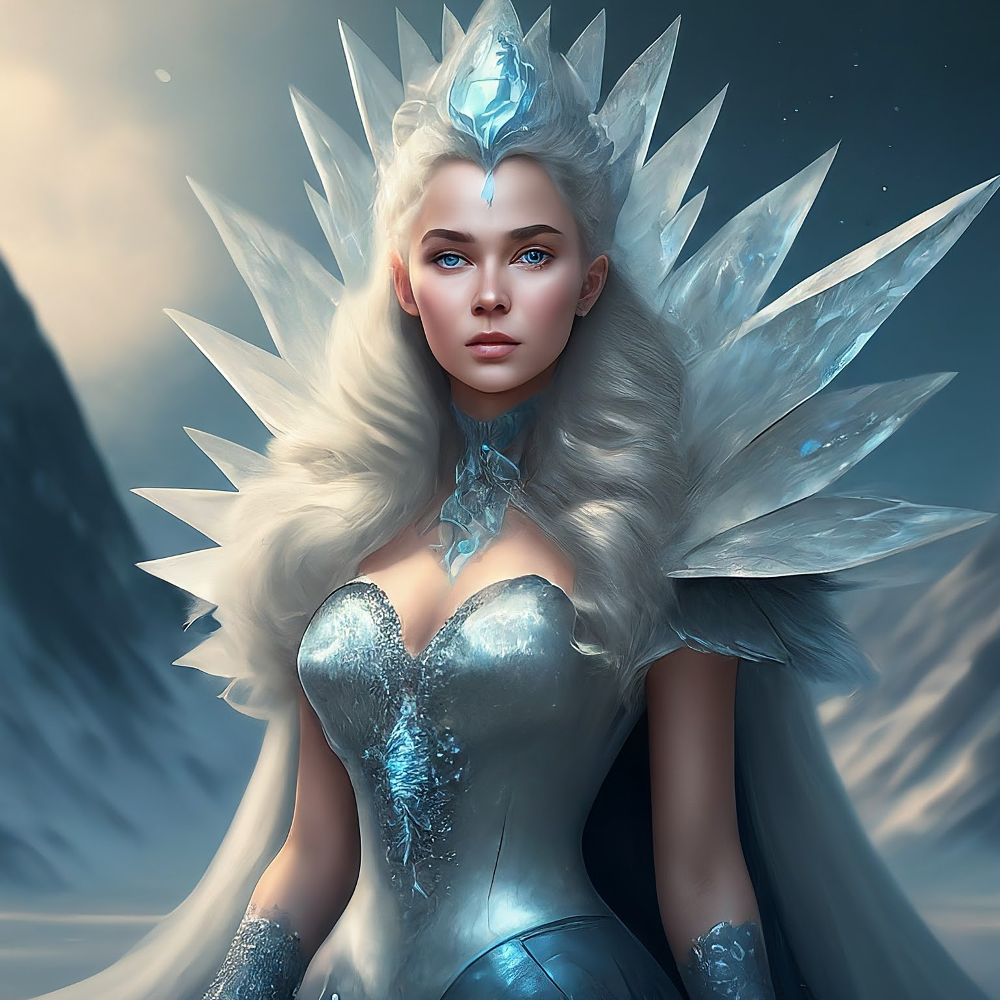

In [5]:
prompt = "A beautiful ice princess with silver hair, fantasy concept art style"

response = generation_model.generate_images(prompt=prompt,)

response.images[0].show()

Now, you have the power to generate the image you desire. Here are some example prompts to inspire you:
- A raccoon wearing formal clothes, wearing a top hat. Oil painting in the style of Vincent Van Gogh.
- A digital collage of famous works of art, all blended together into one cohesive image.
- A whimsical scene from a children's book, such as a tea party with talking animals.
- A futuristic cityscape with towering skyscrapers and flying cars.
- A studio photo of a modern armchair, dramatic lighting, warm.
- A surreal landscape of a city made of ice and snow.

## Prompt Engineering Basics

While there's no one way to write good prompts, adding some keywords and modifiers will help you get closer to your end goal. Prompts don't need to be long or complex, but most good prompts are descriptive and clear.

A good starting point can be to think of subject, context, and style.

<img src = "https://cloud.google.com/static/vertex-ai/generative-ai/docs/image/images/style-subject-context.png">

1. **Subject**: The first thing to think about with any prompt is the subject: the object, person, animal, or scenery you want an image of.

2. **Context and background**: Just as important is the background or context in which the subject will be placed. Try placing your subject in a variety of backgrounds. For example, a studio with a white background, outdoors, or indoor environments.

3. **Style**: Finally, add the style of image you want. Styles can be general (painting, photograph, sketches) or very specific (pastel painting, charcoal drawing, isometric 3D).


## Image Generation Prompt Guide

This guide provides tips for writing effective prompts for image generation models.

### Prompt Structure

A good prompt should be clear, concise, and specific. It should provide enough information for the model to understand what you want to generate, but not so much that it becomes overly restrictive.

**Here are some key elements to consider:**

* **Subject:** What is the main subject of the image?
* **Style:** What artistic style should the image be in? (e.g., realism, impressionism, anime)
* **Composition:** How should the elements of the image be arranged? (e.g., portrait, landscape, abstract)
* **Details:** What specific details should be included in the image? (e.g., colors, textures, objects)

**Example:**

```
A photorealistic portrait of a woman with long flowing hair, wearing a red dress, standing in a field of sunflowers.
```

### Prompting Techniques

**1. Use descriptive language:**

* **Instead of:** "A picture of a cat"
* **Try:** "A photorealistic portrait of a fluffy tabby cat with green eyes, sitting on a windowsill bathed in sunlight."

**2. Provide context:**

* **Instead of:** "A painting of a dragon"
* **Try:** "A fantasy painting of a majestic red dragon soaring through a stormy sky, with lightning illuminating its scales."

**3. Use specific keywords:**

* **Instead of:** "A beautiful landscape"
* **Try:** "A breathtaking landscape with rolling hills, a sparkling lake, and a vibrant sunset."

**4. Experiment with different styles:**

* **Instead of:** "A picture of a dog"
* **Try:** "A cartoon illustration of a playful golden retriever puppy, with big eyes and a wagging tail."

**5. Use negative prompts:**

* **Instead of:** "A picture of a car"
* **Try:** "A picture of a car, but without any wheels."

**6. Use image references:**

* **Instead of:** "A picture of a cat"
* **Try:** "A picture of a cat, similar to the image I've uploaded."

### Examples

**Here are some examples of prompts that you can use to generate images:**

* **Photorealistic portrait of a woman with long flowing hair, wearing a red dress, standing in a field of sunflowers.**
* **A fantasy painting of a majestic red dragon soaring through a stormy sky, with lightning illuminating its scales.**
* **A breathtaking landscape with rolling hills, a sparkling lake, and a vibrant sunset.**
* **A cartoon illustration of a playful golden retriever puppy, with big eyes and a wagging tail.**
* **A surreal abstract painting with swirling colors and geometric shapes.**
* **A photorealistic image of a futuristic city with flying cars and towering skyscrapers.**

### Tips

* **Start with simple prompts and gradually increase complexity.**
* **Experiment with different wording and phrasing.**
* **Use image references to help the model understand your vision.**
* **Be patient and don't be afraid to try different things.**



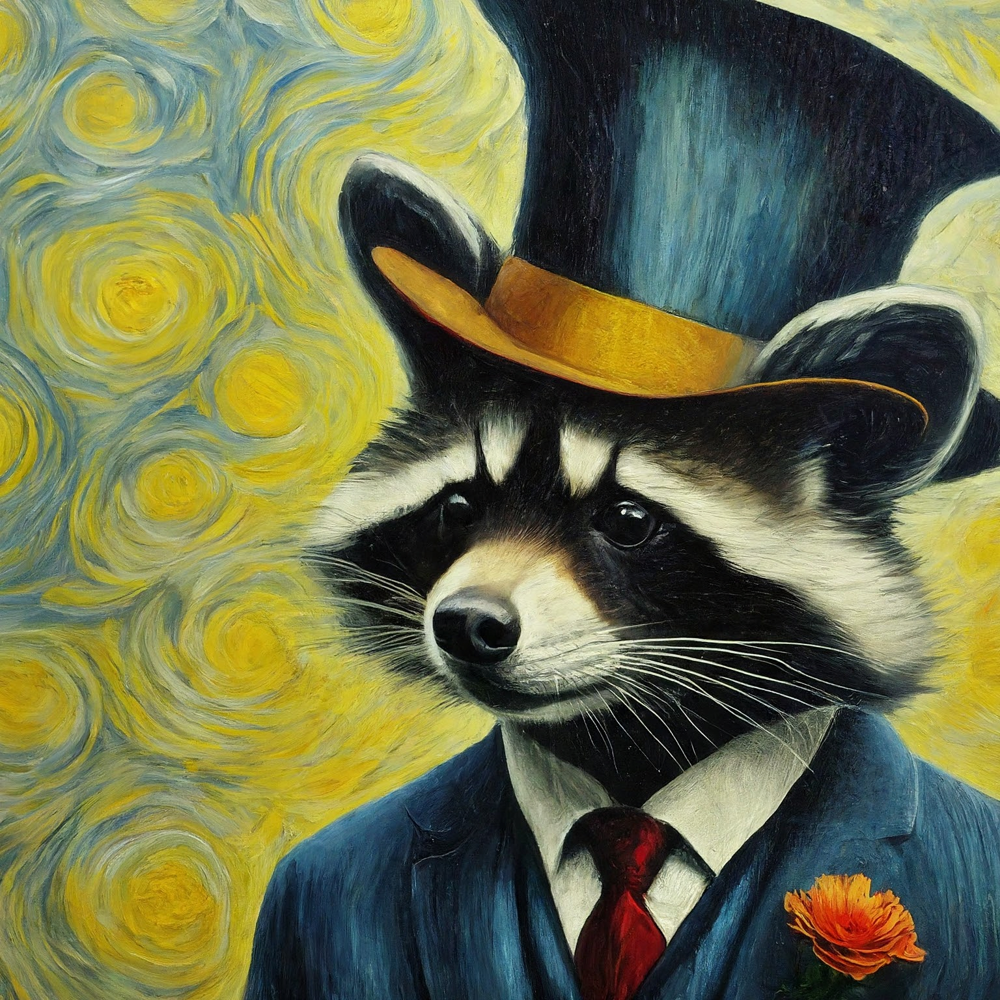

In [6]:
prompt = "A raccoon wearing formal clothes, wearing a top hat. Oil painting in the style of Vincent Van Gogh."

response = generation_model.generate_images(prompt=prompt)

response.images[0].show()

###  Explore different parameters

The `generate_images` function accepts additional parameters that can be used to influence the generated images. The following sections will explore how to influence the output images through the use of those additional parameters.

In [7]:
import math

import matplotlib.pyplot as plt


# An auxiliary function to display images in grid
def display_images_in_grid(images):
    """Displays the provided images in a grid format. 4 images per row.

    Args:
        images: A list of PIL Image objects representing the images to display.
    """

    # Determine the number of rows and columns for the grid layout.
    nrows = math.ceil(len(images) / 4)  # Display at most 4 images per row
    ncols = min(len(images) + 1, 4)  # Adjust columns based on the number of images

    # Create a figure and axes for the grid layout.
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12, 6))

    for i, ax in enumerate(axes.flat):
        if i < len(images):
            # Display the image in the current axis.
            ax.imshow(images[i]._pil_image)

            # Adjust the axis aspect ratio to maintain image proportions.
            ax.set_aspect("equal")

            # Disable axis ticks for a cleaner appearance.
            ax.set_xticks([])
            ax.set_yticks([])
        else:
            # Hide empty subplots to avoid displaying blank axes.
            ax.axis("off")

    # Adjust the layout to minimize whitespace between subplots.
    plt.tight_layout()

    # Display the figure with the arranged images.
    plt.show()

#### `number_of_images`

You can use the `number_of_images` parameter to generate up to four images.

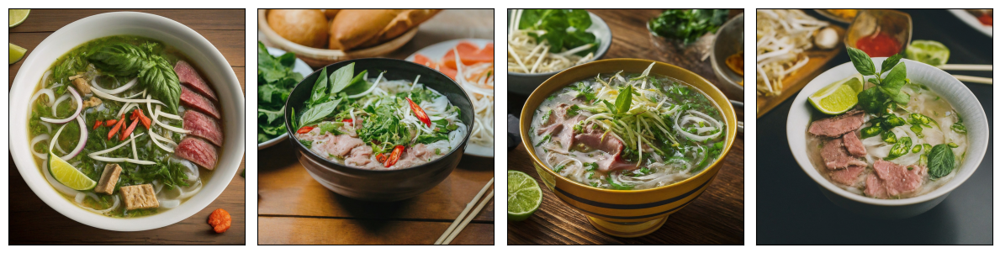

In [8]:
prompt = "a delicious bowl of pho from Vietnam"

response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=4,
)

display_images_in_grid(response.images)

Try running the code a few times and observe the generated images. You will notice that the model generates a new set of images each time, even though the same prompt is used.

#### `seed`

With the `seed` parameter, you can influence the model to create the same output from the same input every time. Please note that the order of the generated images may still change. In order for the call to work when using the `seed` parameter, watermarking has to be disabled.

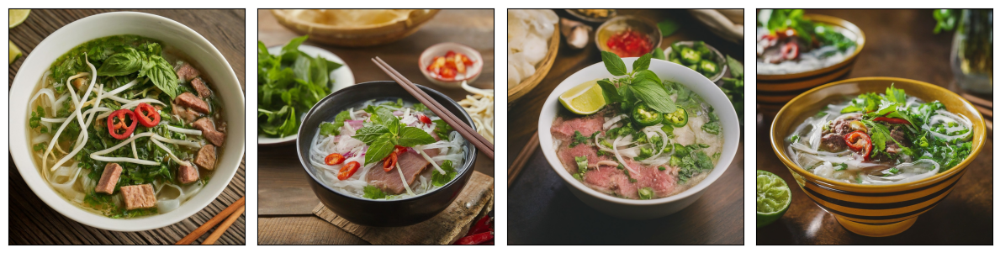

In [9]:
response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=4,
    seed=42,
    add_watermark=False,
)

display_images_in_grid(response.images)

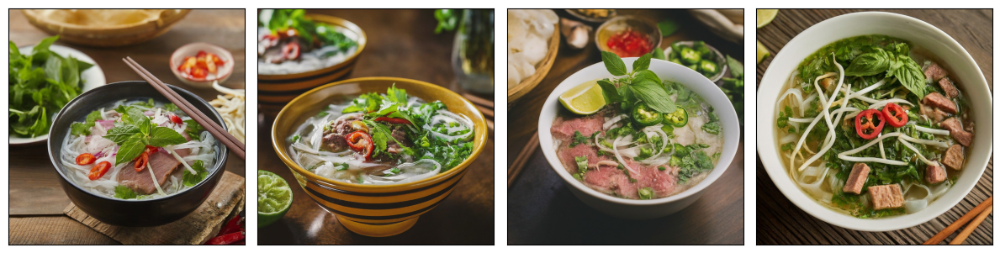

In [10]:
response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=4,
    seed=42,
    add_watermark=False,
)

display_images_in_grid(response.images)

As can be observed, the model produced an identical set of images after utilizing the seed parameter, although the order of the images varies.

#### `negative_prompt`

Objects you do not want to generate can be excluded using the `negative_prompt` parameter. "Bean sprout" was given as a negative prompt in the example below. As a result, despite using the same prompt and seed number, the model did not produce bean sprout in the images.

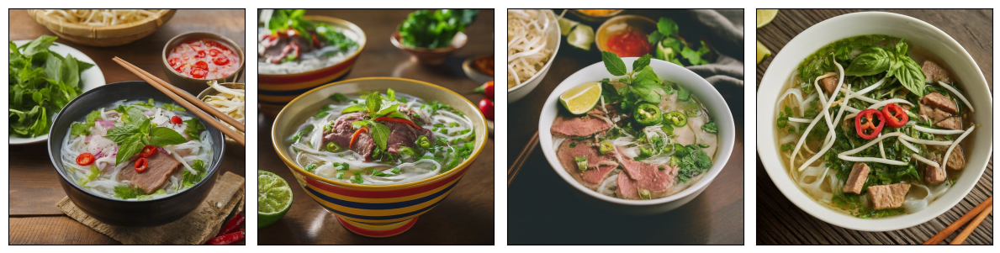

In [19]:
response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=4,
    seed=42,
    negative_prompt="lemon",
    add_watermark=False,
    guidance_scale=2
)

display_images_in_grid(response.images)

#### `aspect_ratio`

Use the `aspect_ratio` parameter to set the ratio of the width to the height of the generated images. The available values are:
- `"16:9"`
- `"4:3"`
- `"3:4"`


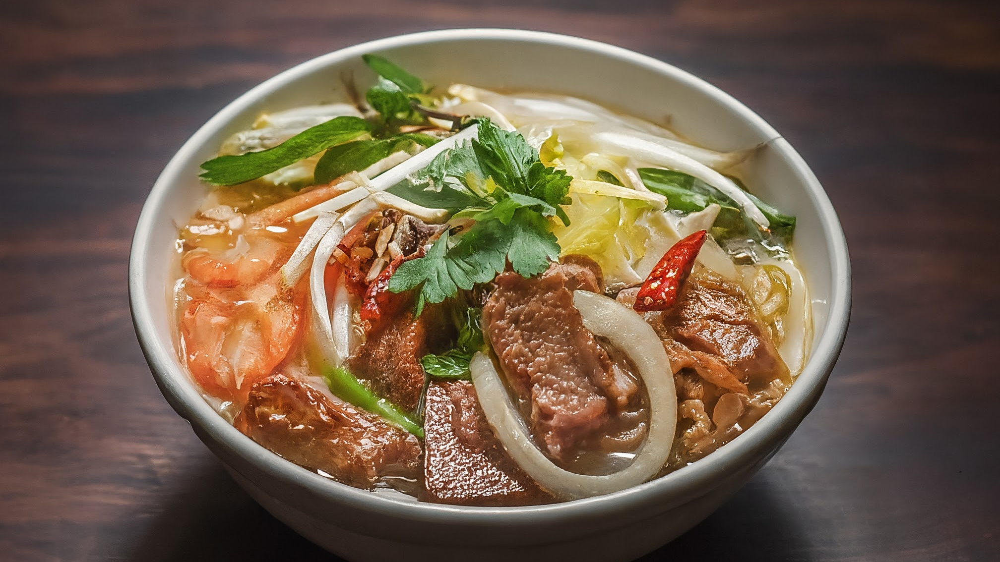

In [12]:
response = generation_model.generate_images(
    prompt=prompt,
    aspect_ratio="16:9",
)

response.images[0].show()

#### `safety_filter_levels`

Use the `safety_filter_levels` parameter to control the level of safety filtering. The available values are:
- `block_most`: The highest level of filtering.
- `block_some`: One level below. Blocks some, but let's some prompts and images pass.
- `block_few`: Blocks fewer prompts and images
- `block_fewest`: Blocks the least amount of images and prompts (available only to allowlisted users/projects)

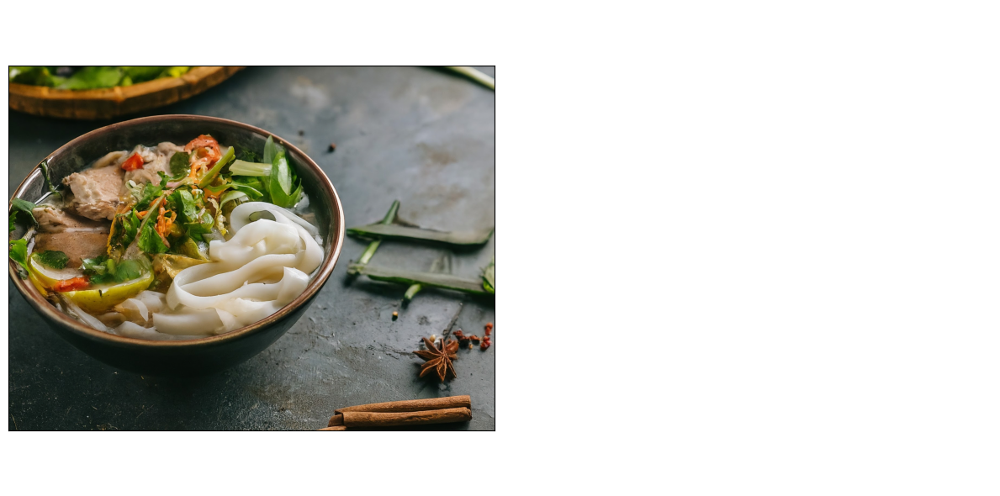

In [13]:
response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=1,
    aspect_ratio="4:3",
    safety_filter_level="block_most",
)

display_images_in_grid(response.images)

#### `add_watermark`

Use the `add_watermark` boolean flag to indicate whether to add [a digital watermark](https://deepmind.google/technologies/synthid/) to the generated images. The default is set to `True`.

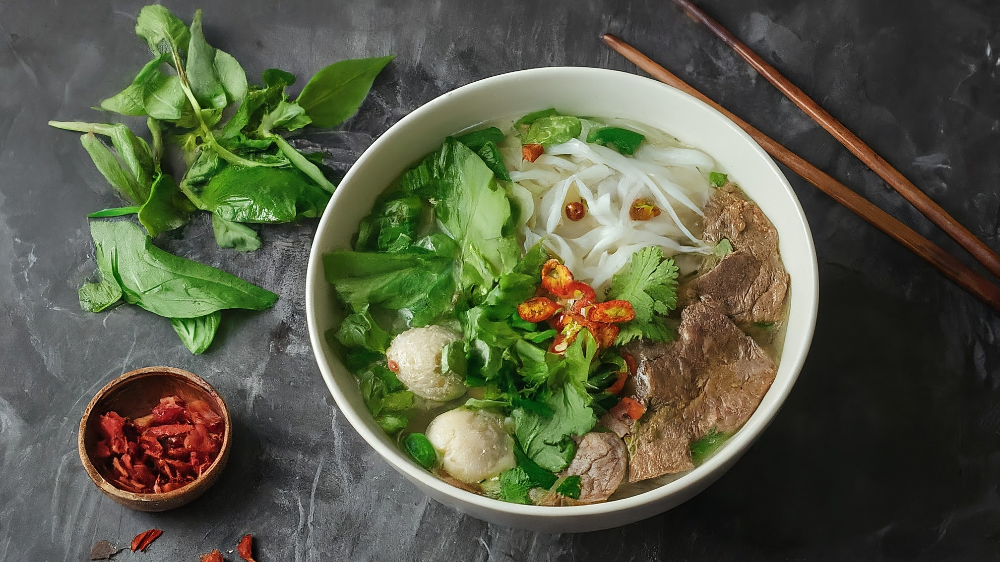

In [14]:
response = generation_model.generate_images(
    prompt=prompt,
    number_of_images=1,
    aspect_ratio="16:9",
    add_watermark=True)

response.images[0].show()

## Conclusion

You have explored the Imagen image generation features through the Vertex AI Python SDK, including the additional parameters that influence image generation.

The next step is to enhance your skills by exploring this [prompting guide](https://cloud.google.com/vertex-ai/docs/generative-ai/image/img-gen-prompt-guide?_ga=2.128324367.-2094800479.1701746552&_gac=1.219926379.1701161688.CjwKCAiAvJarBhA1EiwAGgZl0LFQUFOFZUxfNPlzjB4T00PDiLeCIEYfY-coLbX9eUfHKr_i8VbtSBoCEJQQAvD_BwE).

Through practice, you will become proficient in the art of image prompting.